In [11]:
# Prerequisites:
# pip install torch torchvision torchaudio pandas matplotlib ipywidgets pillow

import torch
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path

In [12]:
# Load YOLOv5s model from Ultralytics

print("[INFO] Loading YOLOv5s model...")
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)
model.eval()
print("[SUCCESS] YOLOv5 model loaded.\n")

[INFO] Loading YOLOv5s model...


Using cache found in C:\Users\Hassan/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-5-18 Python-3.12.3 torch-2.7.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


[SUCCESS] YOLOv5 model loaded.



In [13]:
# Detect ingredients from image

image_path = "D:/AI-CCP/Available_Ingredients"

def detect_ingredients(image_path):
    if not Path(image_path).exists():
        print(f"[ERROR] Image path does not exist: {image_path}")
        return []
    
    print(f"[INFO] Running object detection on: {image_path}")
    img = Image.open(image_path)
    results = model(img)
    results.print()
    results.show()
    df = results.pandas().xyxy[0]
    detected = df['name'].tolist()
    unique_detected = list(set(detected))
    print("[DETECTED INGREDIENTS]:", unique_detected)
    return unique_detected



In [14]:
# Generate cookie cutter recipe based on selections

def generate_recipe(ingredients, dish_type, diet):
    base_steps = {
        'Salad': [
            "Wash and chop all ingredients.",
            "Mix everything in a large bowl.",
            "Add seasoning and dressing to taste.",
            "Serve chilled."
        ],
        'Dessert': [
            "Combine ingredients in a mixing bowl.",
            "Prepare a batter or mixture as needed.",
            "Bake or chill as required.",
            "Serve as a sweet treat."
        ],
        'Main Course': [
            "Prepare all ingredients: chop, marinate, etc.",
            "Cook protein and vegetables in a pan.",
            "Combine and simmer with spices.",
            "Serve hot with rice or bread."
        ],
        'Soup': [
            "Boil water or stock in a large pot.",
            "Add chopped ingredients and seasonings.",
            "Simmer until everything is tender.",
            "Blend if needed and serve warm."
        ],
        'Snack': [
            "Prepare bite-sized ingredients.",
            "Cook quickly by frying, baking, or mixing.",
            "Add toppings or dips.",
            "Enjoy your snack!"
        ]
    }

    recipe = f"\n=== {diet} {dish_type} Recipe ===\n"
    recipe += "\nIngredients:\n" + "\n".join(f"- {item}" for item in ingredients)
    recipe += "\n\nInstructions:\n"
    for i, step in enumerate(base_steps[dish_type], 1):
        recipe += f"{i}. {step}\n"
    return recipe

In [15]:
# Hardcoded Inputs

# Set image path
image_path = "Available_Ingredients/IMG_20250517_192047.jpg"  # Change this path to your actual image file

# Extra ingredients (comma-separated string)
extra_text = "Chicken, Olive Oil"

# Dish category and diet preference
dish_type = "Main Course"  # options: Salad, Dessert, Main Course, Soup, Snack

[INFO] Running object detection on: Available_Ingredients/IMG_20250517_192047.jpg


C:\Users\Hassan/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:907: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 2080x4624 3 oranges
Speed: 101.0ms pre-process, 64.0ms inference, 1.0ms NMS per image at shape (1, 3, 288, 640)


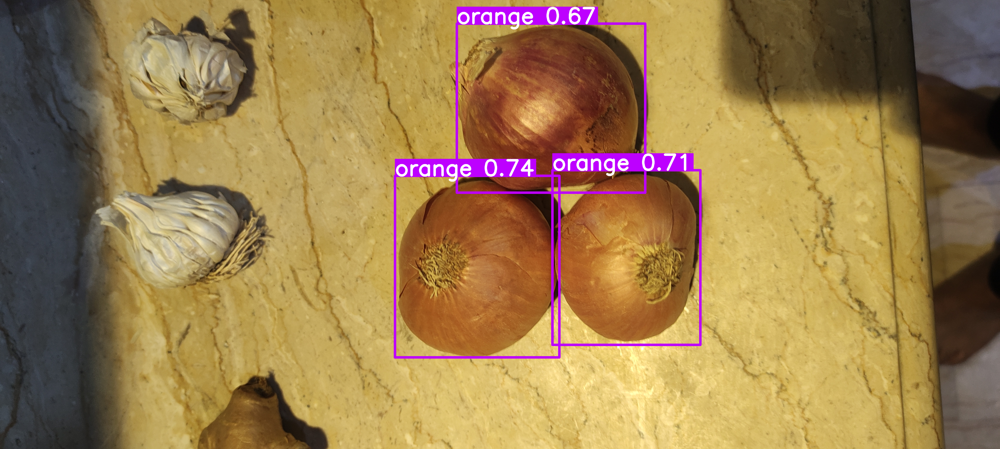

[DETECTED INGREDIENTS]: ['orange']


=== None Main Course Recipe ===

Ingredients:
- Chicken
- Olive Oil
- orange

Instructions:
1. Prepare all ingredients: chop, marinate, etc.
2. Cook protein and vegetables in a pan.
3. Combine and simmer with spices.
4. Serve hot with rice or bread.



In [16]:
# Run full flow

# Detect from image
detected = detect_ingredients(image_path)

# Combine with extra ingredients
extra_list = [x.strip() for x in extra_text.split(",") if x.strip()]
all_ingredients = sorted(set(detected + extra_list))

# Generate and print recipe
print("\n" + "=" * 50)
final_recipe = generate_recipe(all_ingredients, dish_type, diet_pref)
print(final_recipe)
print("=" * 50)
